In [96]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc
import seaborn as sns

# %load_ext nb_black
use_cuda = True
sc.set_figure_params(dpi=200)

In [2]:
import sys
sys.path.append('/home/angela/src/scVI_TSP/')
sys.path.append('/home/angela/sapiens/tabula-sapiens/')
# from utils.annotations_utils import *
from utils.colorDict import *
from utils.general_utils import *
from utils.plotting_utils import *

In [3]:
import matplotlib.pyplot as plt

%matplotlib inline

In [4]:
data_path = "/mnt/ibm_lg/angela/sapiens/data/"

In [5]:
adata = read_h5ad(data_path + "Pilot1_Pilot2.decontX.h5ad")
adata

AnnData object with n_obs × n_vars = 150084 × 58870
    obs: 'X10X_run', 'smartseq2_barcode', 'smartseq2_library_plate', 'smartseq2_sorting_direction', 'smartseq2_sort_order', 'smartseq2_cDNA_Plate', 'cell_id', 'method', 'donor', 'X10X_replicate', 'sequencer', 'sex', 'tissue', 'smartseq2_well_seq', 'notes', 'smartseq2_sorted_population', 'X10X_sample', 'anatomical_position', 'X10X_barcode', 'n_counts', 'n_genes', 'manual_cell_ontology_class', 'manual_annotation', 'doublet_filter', 'compartment', 'batch', 'compartment_pred', 'leiden', 'cluster_id', 'Propagated.Annotation', 'Entropy.All.Methods', 'Entropy.kNN.Reps', 'Entropy.scANVI.Reps', 'Entropy.SVM.Reps', 'Potential.Doublets', 'Onclass', 'singlecellNet', 'kNN', 'SVM', 'scANVI', 'compartment_pred_svm', 'manual_cell_ontology_classcollapsed', 'Propagated.Annotationcollapsed', 'Onclasscollapsed', 'singlecellNetcollapsed', 'kNNcollapsed', 'SVMcollapsed', 'scANVIcollapsed', 'miscompartmentalized', 'log_n_counts', 'log_n_genes', 'donor_metho

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
Trying to set attribute `.var` of view, copying.
/home/angela/.local/lib/python3.7/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 11004. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


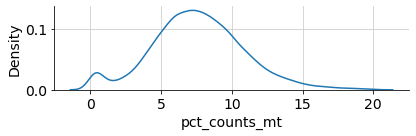

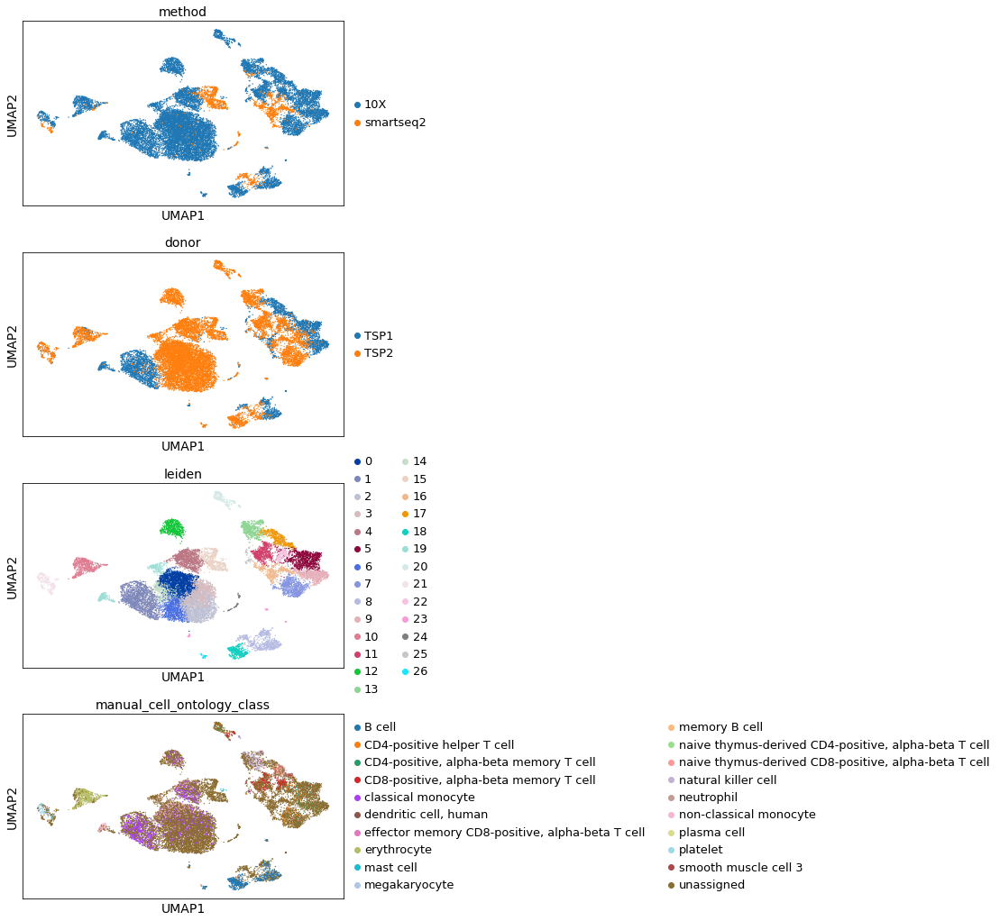

In [6]:
organ = "Blood"
organ_adata = adata[adata.obs["tissue"] == organ]

organ_adata.var['mt'] = organ_adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(organ_adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sns.displot(data=organ_adata.obs, x="pct_counts_mt", kind="kde", height=2, aspect=3)

sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=1)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [7]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

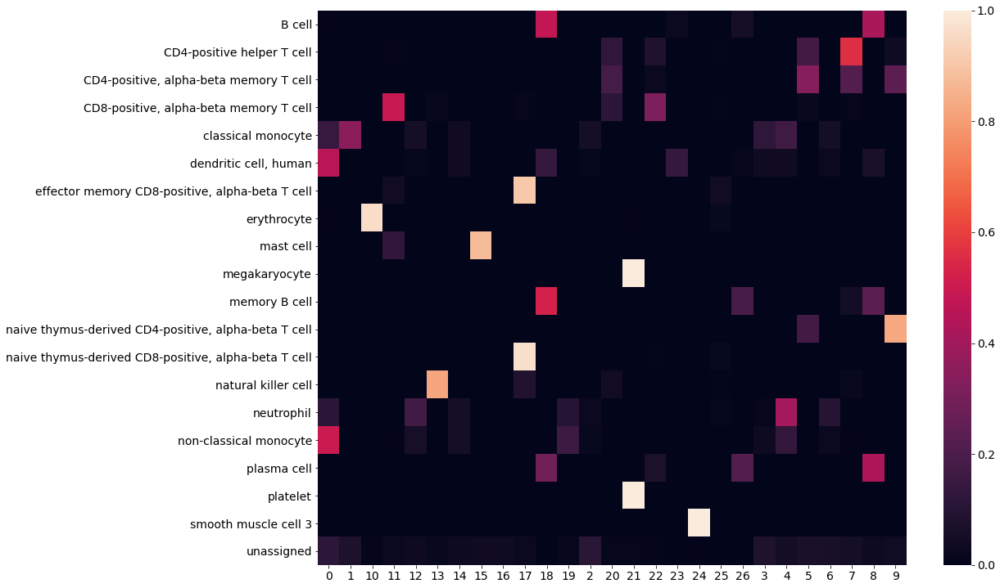

In [8]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.sum(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [9]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [10]:
cluster_composition["0"]

['B cell: 0.00',
 'classical monocyte: 0.11',
 'dendritic cell, human: 0.02',
 'erythrocyte: 0.00',
 'neutrophil: 0.00',
 'non-classical monocyte: 0.17',
 'unassigned: 0.69']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [11]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [12]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

/home/angela/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in long_scalars
  """


In [13]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


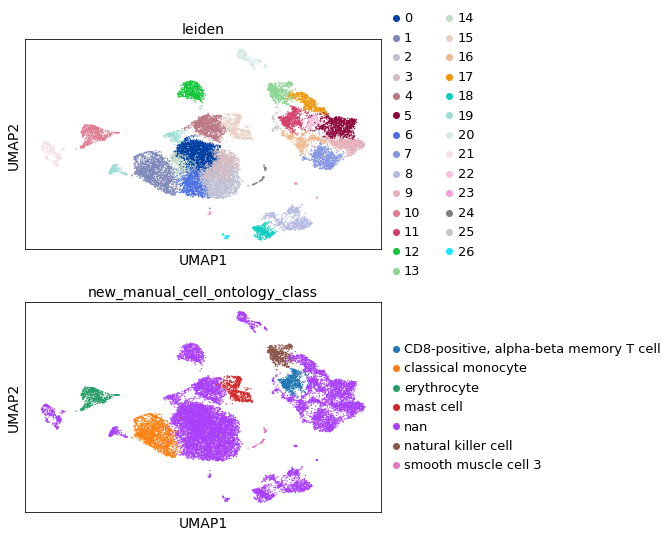

In [14]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

In [15]:
organ_adata.obs.groupby(["leiden"]).agg(
    {"new_manual_cell_ontology_class": set, "Propagated.Annotation": set}
)

,new_manual_cell_ontology_class,Propagated.Annotation
leiden,,
0,{nan},"{cell, dendritic cell, human, neutrophil, clas..."
1,{classical monocyte},"{neutrophil, non-classical monocyte, classical..."
2,{nan},"{cell, CD8-positive, alpha-beta memory T cell,..."
3,{nan},"{cell, dendritic cell, human, neutrophil, clas..."
4,{nan},"{cell, dendritic cell, human, neutrophil, clas..."
5,{nan},"{CD4-positive helper T cell, CD8-positive, alp..."
6,{nan},"{cell, B cell, dendritic cell, human, neutroph..."
7,{nan},"{CD4-positive helper T cell, CD8-positive, alp..."
8,{nan},"{CD4-positive helper T cell, CD4-positive, alp..."


/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


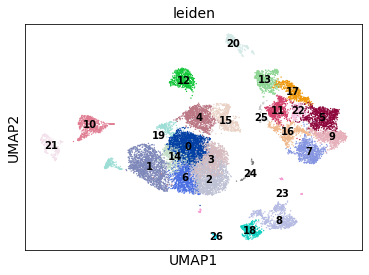

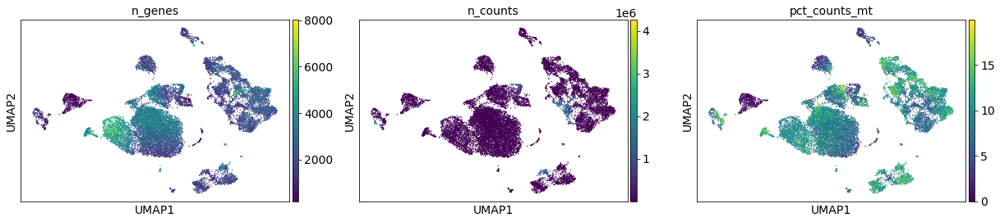

In [16]:
sc.pl.umap(organ_adata, color="leiden", legend_loc="on data")
sc.pl.umap(organ_adata,color=['n_genes','n_counts','pct_counts_mt'])

In [17]:
sc.tl.rank_genes_groups(organ_adata,'leiden',method='wilcoxon')

In [19]:
 pd.set_option('display.max_columns', 30)

In [20]:
organ_cluster_genes = pd.DataFrame(organ_adata.uns['rank_genes_groups']['names'])
organ_cluster_genes.iloc[:20]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26
0,CD163,FCN1,S100A8,S100A9,MTCO1P12,LTB,FOLR3,RPS26,MS4A1,CCR7,HBB,CCL5,GABARAP,GNLY,PPBP,AL512646.1,EEF1A1P5,NKG7,CD79A,FCGR3A,IFITM1,TUBB1,IL32,SPINT2,CSF3R,CD2,CD79A
1,RNASE1,CD14,S100A12,S100A12,CD163,TRAC,IFITM2,GAS5,CD79A,TCF7,HBA2,GZMA,NME2,KLRD1,NRGN,MT-RNR2,EEF1A1,CST7,IGHM,LST1,PTPRCAP,PF4,CD3D,HINT1,AL512646.1,IL32,MS4A1
2,CST3,SERPINA1,FOLR3,LGALS1,CTSB,IL32,RBP7,RPS12,IGHM,BCL11B,HBA1,LYAR,ATP6V0C,NKG7,TUBB1,MTRNR2L12,B2M,GZMA,TNFRSF13C,MS4A7,RPS26,PPBP,TRAC,RPS23,ALPL,CD3D,CD74
3,VSIG4,FPR1,RBP7,VCAN,METTL7A,RPS29,NAMPT,CD69,CD79B,RPS29,ALAS2,CST7,ALDOA,GZMA,PF4,MT-ATP8,EEF1A1P6,PRF1,IGHD,SMIM25,CD3E,ITGA2B,CD2,RPLP0,SLC25A37,GZMA,PTPRCAP
4,MTND1P23,CLEC12A,S100A9,LYZ,ADA2,IL7R,CLEC4E,RPL10P9,HLA-DPB1,PRKCQ-AS1,SLC25A37,IL7R,IFITM3,PRF1,ITGA2B,RPL13P12,MT-CO3,CCL5,MS4A1,TCF7L2,IL32,CAVIN2,LCK,RPS5,BASP1,CD3G,BLK
5,CTSB,LTA4H,IL1R2,S100A8,FKBP5,BCL11B,AC020656.1,RPL30,CD74,RPS27,SLC25A39,FGFBP2,IFI30,GZMB,TREML1,FTH1P20,MT-CYB,GZMM,JUND,AIF1,IL7R,GP9,CD3G,PEBP1,CXCR2,SYNE2,CD79B
6,NPC2,CD36,PLBD1,CAPG,KCTD12,CD3D,S100A8,RPS27A,HLA-DRA,CD3E,SNCA,GNLY,GNG5,HOPX,CAVIN2,SLC11A1,RPL13AP5,CTSW,CXCR4,IFITM3,NME2,GNG11,ISG20,RPL37,IL1R2,TRBC2,HLA-DPB1
7,HMOX1,JAML,AC020656.1,AC020656.1,IRAK3,CD3E,S100A12,IL7R,CD37,LDHB,GYPC,CD3D,AL138963.3,KLRF1,GNG11,RPS28P7,MALAT1,KLRD1,BTG1,HLA-DPA1,ZAP70,MPIG6B,CD27,EEF1B2,IFITM2,CST7,IGHM
8,MS4A6A,MNDA,SERPINB1,SERPINB1,MARCH1,LDHB,IRS2,RPL14,BANK1,LTB,YBX3,PPP2R5C,STAB1,CTSW,SPARC,AC114801.3,MT-CO1,GNLY,HLA-DQA1,FCER1G,LCK,TREML1,ARL4C,RPS21,MMP25,CCL5,HLA-DQA2
9,KLF10,CSF3R,LGALS1,RNASE2,HMOX1,CD3G,AC020916.1,LEPROTL1,LINC00926,LEF1,HBD,CXCR4,CFP,CST7,CLU,FTLP3,RPL23A,CCL4,AL139020.1,IFITM2,MIF,SPARC,CD3E,HSP90AB1,LRG1,ETS1,AL139020.1


In [72]:
g = list(organ_cluster_genes["12"].head(10))
g = ",".join(g)
print(g)

GABARAP,NME2,ATP6V0C,ALDOA,IFITM3,IFI30,GNG5,AL138963.3,STAB1,CFP


In [73]:
set(organ_adata.obs[organ_adata.obs['leiden']=='12']['manual_annotation'])

{'B cell',
 'classical monocyte',
 'dendritic cell',
 'natural killer cell',
 'neutrophil',
 'non-classical monocyte',
 'unassigned'}

In [78]:
cluster_composition["0"]

['B cell: 0.00',
 'classical monocyte: 0.11',
 'dendritic cell, human: 0.02',
 'erythrocyte: 0.00',
 'neutrophil: 0.00',
 'non-classical monocyte: 0.17',
 'unassigned: 0.69']

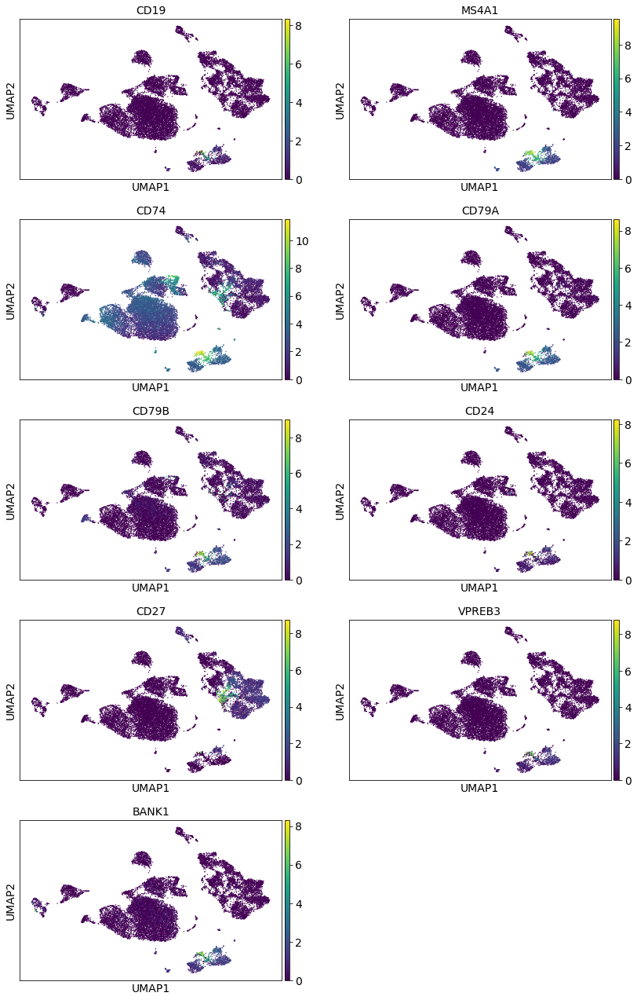

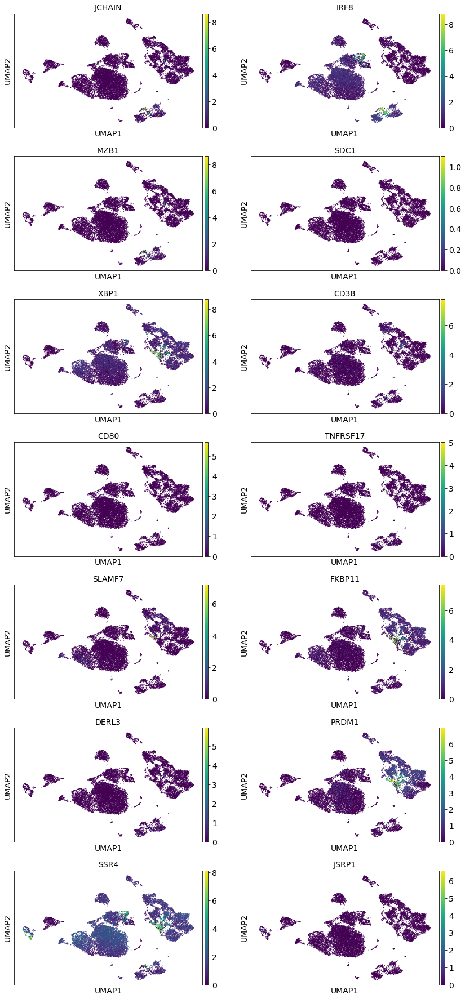

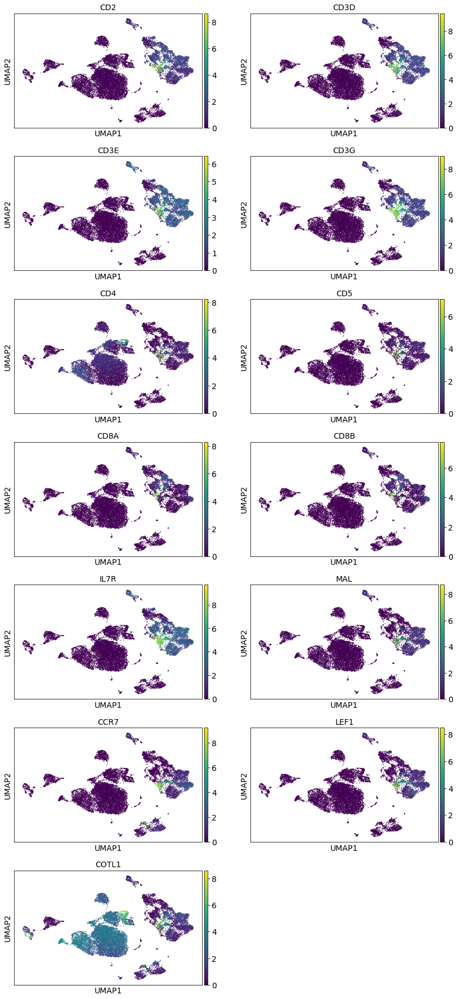

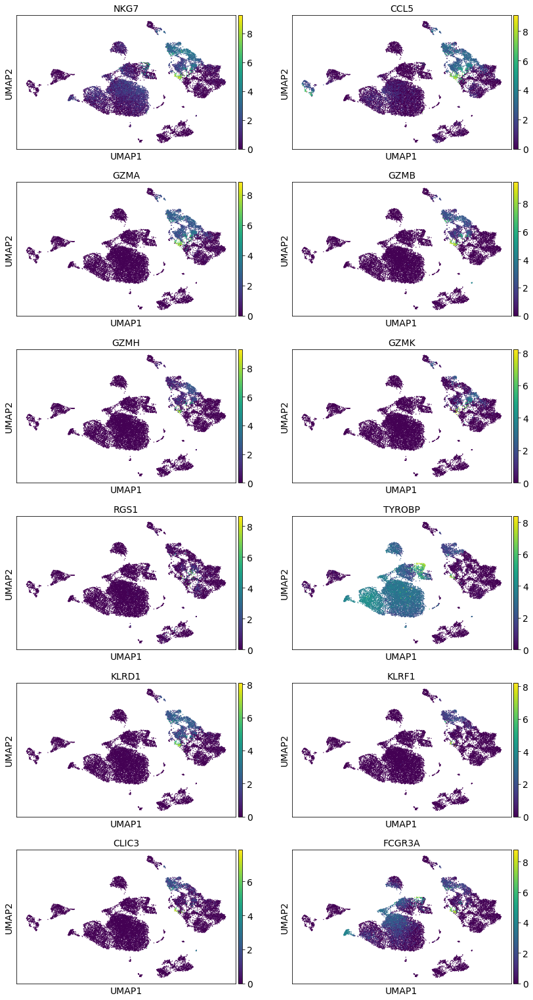

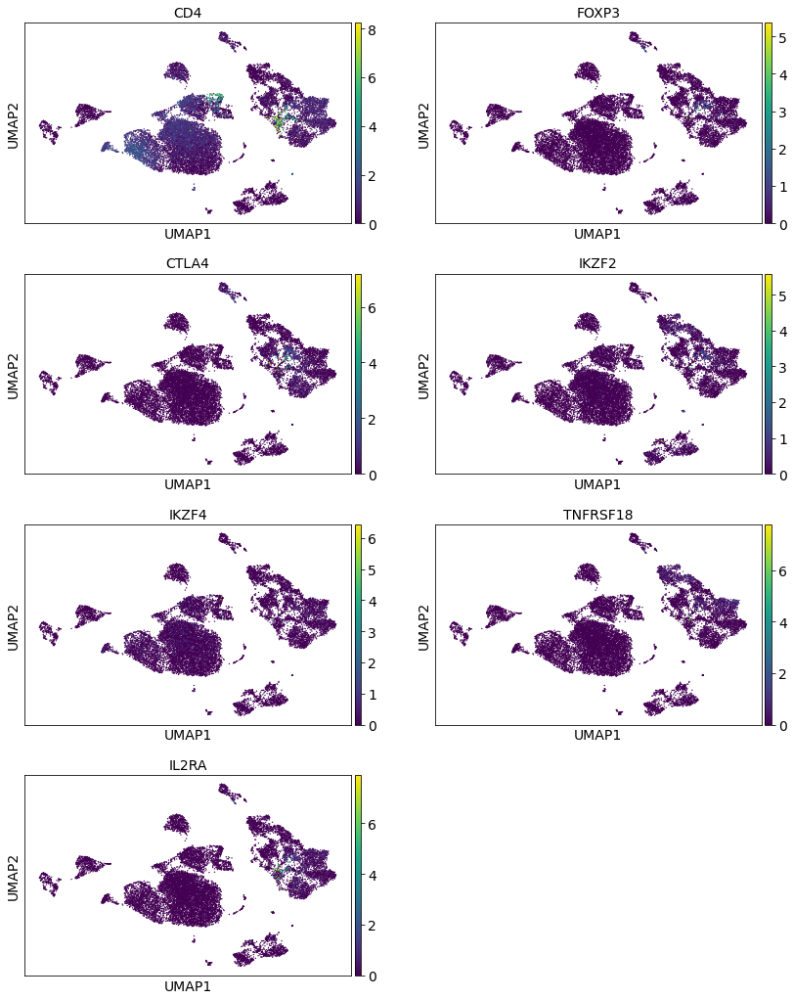

...

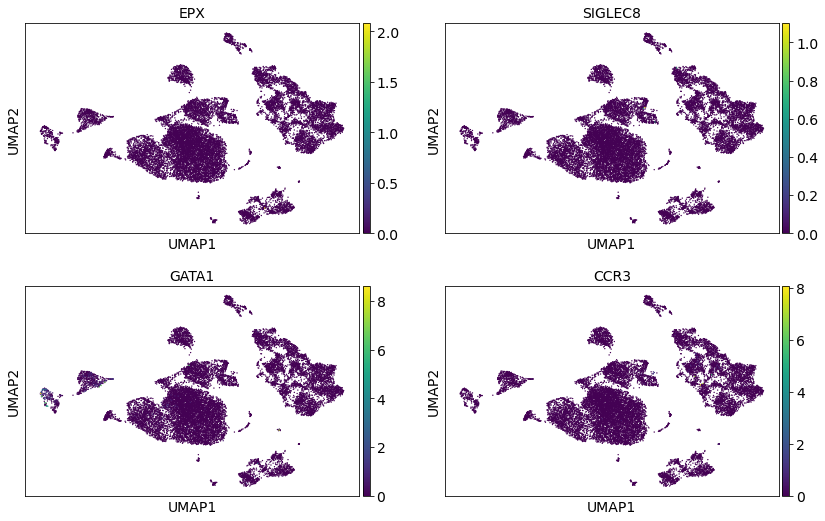

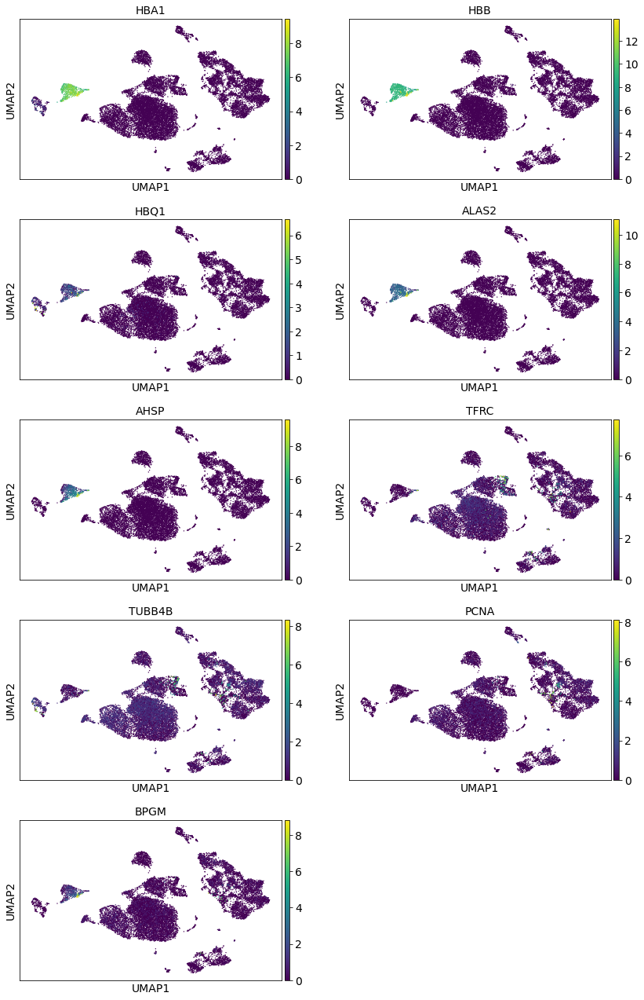

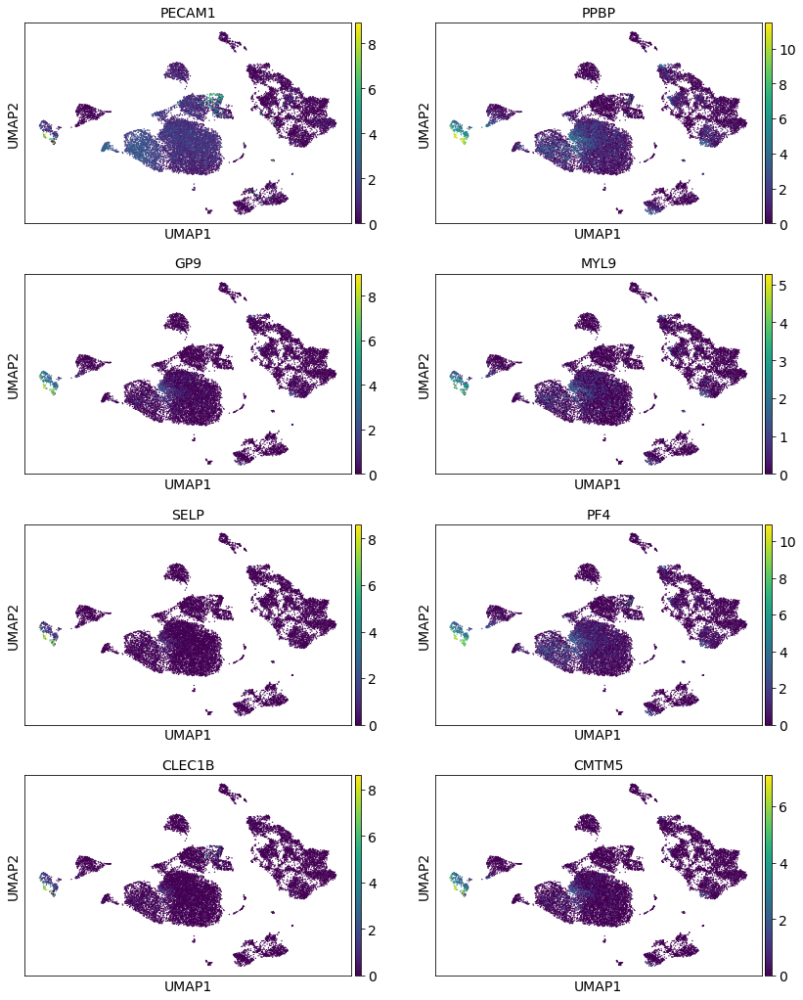

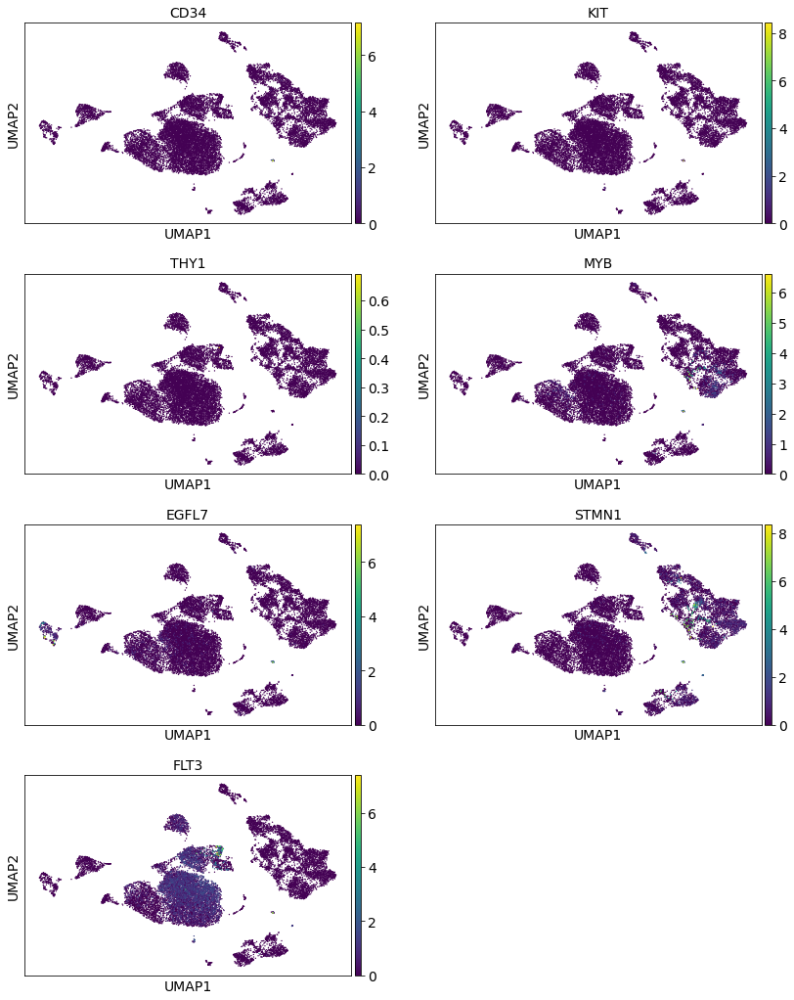

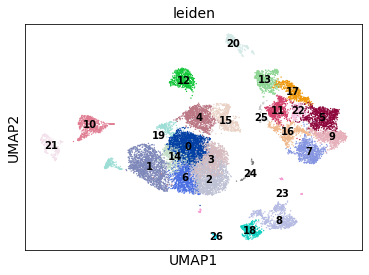

In [81]:
sc.pl.umap(organ_adata,color=["CD19", "MS4A1", "CD74", "CD79A", "CD79B", "CD24", "CD27","VPREB3", "BANK1"],ncols=2) # b_cells
sc.pl.umap(organ_adata,color=["JCHAIN", "IRF8","MZB1", "SDC1", "XBP1","CD38","CD80","TNFRSF17","SLAMF7", "FKBP11","DERL3","PRDM1", "SSR4", "JSRP1"],ncols=2) # genes_plasma_cells
sc.pl.umap(organ_adata,color=["CD2", "CD3D", "CD3E", "CD3G", "CD4", "CD5", "CD8A", "CD8B", "IL7R","MAL","CCR7","LEF1", "COTL1"],ncols=2) # genes_t_nkt_nk_cells_1
sc.pl.umap(organ_adata,color=["NKG7", "CCL5","GZMA","GZMB", "GZMH","GZMK","RGS1", "TYROBP", "KLRD1","KLRF1", "CLIC3","FCGR3A"],ncols=2) # genes_t_nkt_nk_cells_2
sc.pl.umap(organ_adata,color=["CD4", "FOXP3", "CTLA4", "IKZF2", "IKZF4", "TNFRSF18", "IL2RA"],ncols=2) # genes_t_nkt_nk_cells_3
sc.pl.umap(organ_adata,color=["CD3E", "KLRB1", "CEBPD", "ZBTB16","HOPX", "NCR3", "KLRC1"],ncols=2) # genes_t_nkt_nk_cells_4
sc.pl.umap(organ_adata,color=["NKG7","FCER1G", "KLRB1","FCGR3A","NCAM1","SPON2","FGFBP2","CHST2","XCL1", "AREG", "SELL", "COTL1"],ncols=2) # genes_t_nkt_nk_cells_5
sc.pl.umap(organ_adata,color=["AREG", "KIT", "RORA", "RORC", "IL1R1", "IL2RA", "NCR2", "GATA3", "IL4", "IL5", "IL13", "IL17RB"],ncols=2) # genes_ilc_cells
sc.pl.umap(organ_adata,color=["TYROBP","S100A8","S100A10","CSF3R", "ALPL", "FCGR3B","MMP9","PGLYRP1","CAMP","AZU1","LTF"],ncols=2) # genes_neutrophils
sc.pl.umap(organ_adata,color=["FCN1","LILRA1", "LGALS1", "AHNAK", "VCAN", "CD14","FCGR3A", "CCR2", "S100A12", "CSF3R", "HES4","CDKN1C"],ncols=2) # genes_monocytes
sc.pl.umap(organ_adata,color=["CD74","CD163","C1QA", "C1QC", "MARCO","APOE", "MSR1", "MRC1","GPD1","LTC4S", "LPL", "SIGLEC1","VSIG4"],ncols=2) # genes_macrophages
sc.pl.umap(organ_adata,color=["CD1C", "CD1E", "CLEC10A", "PKIB", "PLD4", "GPR183", "CLEC9A","THBD", "LAMP3", "CCL22", "WFDC21P", "IDO1", "RAMP1"],ncols=2) # genes_conventional_dendritic_cells
sc.pl.umap(organ_adata,color=["LILRA4", "SCT", "LRRC26", "CLEC4C", "SMPD3", "LAMP5", "RUNX2", "IL3RA"],ncols=2) # genes_plasmacytoid_dendritic_cells
sc.pl.umap(organ_adata,color=['FCER1A',"MS4A2", "GATA2", "IL3RA", "CPA3","HDC"],ncols=2) # genes_basophils_mast_cells
sc.pl.umap(organ_adata,color=["EPX", "SIGLEC8", "GATA1", "CCR3"],ncols=2) # genes_eosinophils
sc.pl.umap(organ_adata,color=["HBA1","HBB", "HBQ1","ALAS2","AHSP","TFRC", "TUBB4B", "PCNA", "BPGM"],ncols=2) # genes_erythrocytes
sc.pl.umap(organ_adata,color=["PECAM1","PPBP", "GP9", "MYL9", "SELP","PF4",  "CLEC1B", "CMTM5"],ncols=2) # genes_platelets
sc.pl.umap(organ_adata,color=["CD34","KIT","THY1", "MYB", "EGFL7", "STMN1", "FLT3"],ncols=2) # genes_hsc

# sc.pl.umap(organ_adata,color=[]) # 
# sc.pl.umap(organ_adata,color=[]) # 
# sc.pl.umap(organ_adata,color=[]) # 
# sc.pl.umap(organ_adata,color=[]) # 
# sc.pl.umap(organ_adata,color=[''])# scratching 

sc.pl.umap(organ_adata,color='leiden',legend_loc='on data')

# sc.pl.umap(organ_adata,color='anatomical_position')

In [210]:
leiden_cell_type = {
    "0": "monocyte",
    "1": "monocyte",
    "2": "monocyte",
    "3": "monocyte",
    "4": "monocyte",
    "5": "T cell",
    "6" : "monocyte",
    "7": "T cell",
    "8": "B cell", # + plasma cells
    "9": "T cell",
    "10": "erythrocyte",
    "11": "T cell",
    "12": "monocyte",
    "13": "NK cell",
    "14": "monocyte",
    "15": "monocyte",
    "16": "T cell", #CD27 and CD4+CD8+ T cell
    "17": "T cell",
    "18": "B cell",
    "19": "monocyte",
    "20": "T cell", 
    "21": "platelet",
    "22": "T cell",
    "23": "B cell",
    "24": "neutrophil",
    "25": "T cell",
    "26": "B cell",
}    

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [211]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()


This cell will automatically replace the leiden cluster names with cell type annotations

In [212]:
for l in leiden_cell_type.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, leiden_cell_type[l], inplace=True)

# Visualize the results of the manual annotation

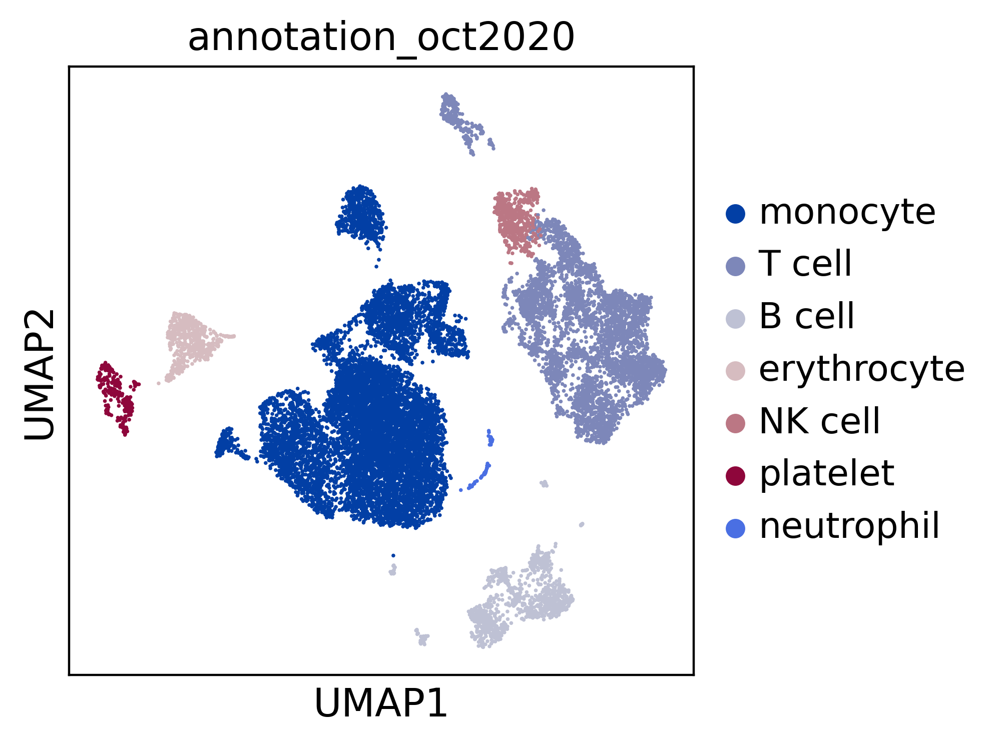

In [213]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# subcluster

## T cells and NK cells

In [92]:
t_nk_cells = organ_adata[organ_adata.obs["annotation_oct2020"].isin(["T cell","NK cell"])]
t_nk_cells

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 4663 × 58870
    obs: 'X10X_run', 'smartseq2_barcode', 'smartseq2_library_plate', 'smartseq2_sorting_direction', 'smartseq2_sort_order', 'smartseq2_cDNA_Plate', 'cell_id', 'method', 'donor', 'X10X_replicate', 'sequencer', 'sex', 'tissue', 'smartseq2_well_seq', 'notes', 'smartseq2_sorted_population', 'X10X_sample', 'anatomical_position', 'X10X_barcode', 'n_counts', 'n_genes', 'manual_cell_ontology_class', 'manual_annotation', 'doublet_filter', 'compartment', 'batch', 'compartment_pred', 'leiden', 'cluster_id', 'Propagated.Annotation', 'Entropy.All.Methods', 'Entropy.kNN.Reps', 'Entropy.scANVI.Reps', 'Entropy.SVM.Reps', 'Potential.Doublets', 'Onclass', 'singlecellNet', 'kNN', 'SVM', 'scANVI', 'compartment_pred_svm', 'manual_cell_ontology_classcollapsed', 'Propagated.Annotationcollapsed', 'Onclasscollapsed', 'singlecellNetcollapsed', 'kNNcollapsed', 'SVMcollapsed', 'scANVIcollapsed', 'miscompartmentalized', 'log_n_counts', 'log_n_genes', 'donor

In [103]:
# sc.pp.neighbors(t_nk_cells, use_rep="X_scvi_decontX")#, n_neighbors=10)
# sc.tl.umap(t_nk_cells)
# t_nk_cells.obsm["X_umap_decontX"] = t_nk_cells.obsm["X_umap"].copy()
sc.tl.leiden(t_nk_cells, resolution=1)

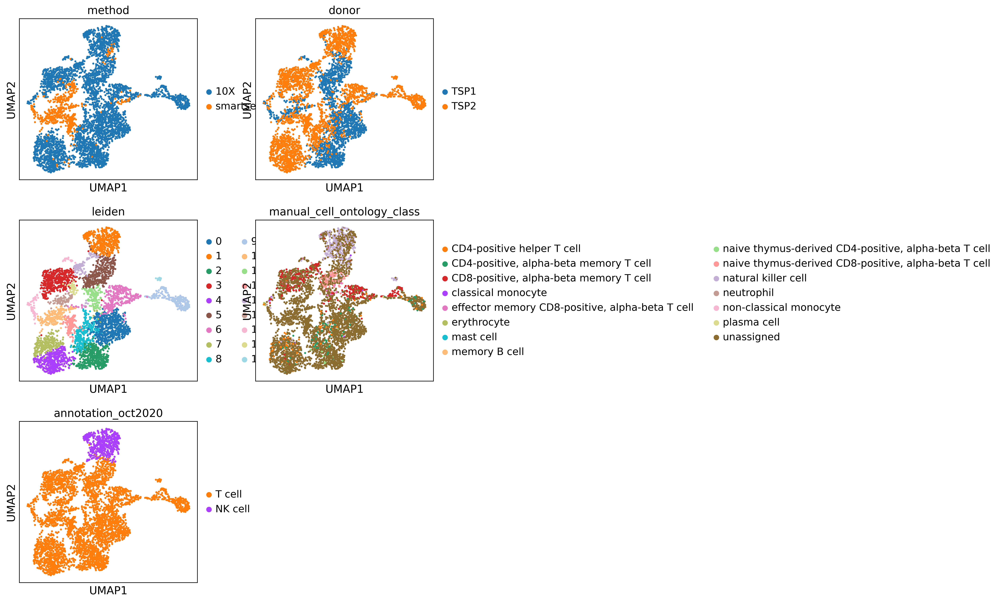

In [104]:
sc.pl.umap(
    t_nk_cells,
    color=["method", "donor", "leiden", "manual_cell_ontology_class","annotation_oct2020"],
    ncols=2,
)

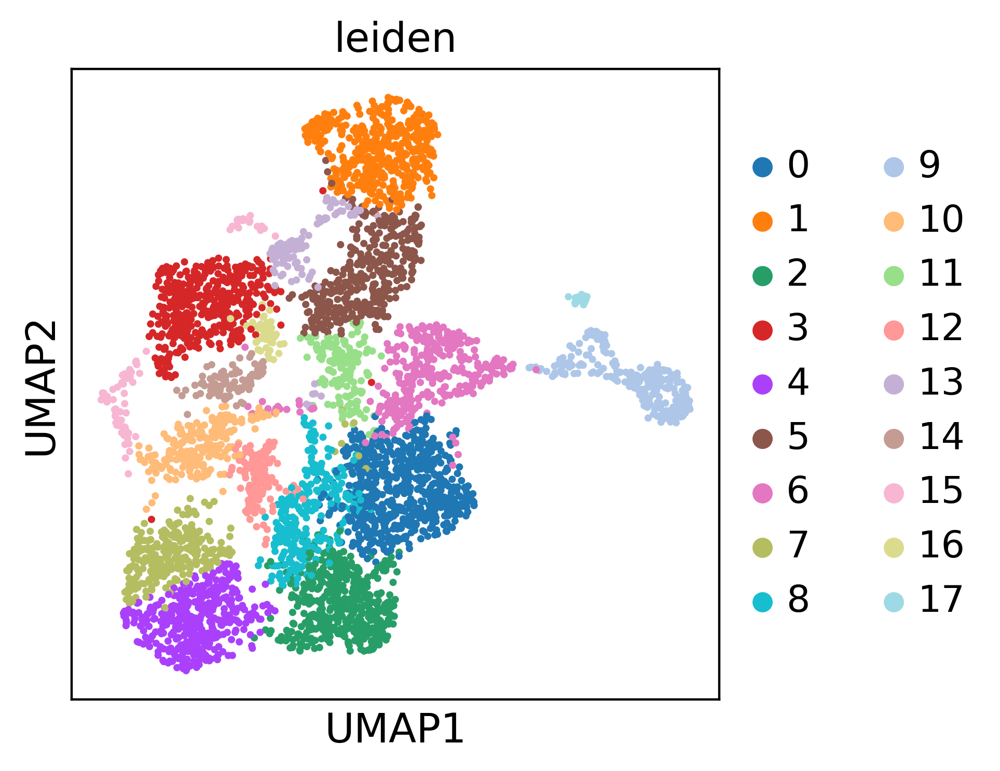

In [105]:
sc.pl.umap(
    t_nk_cells,
    color=["leiden"],
    ncols=2,
)

In [117]:
# sc.pl.umap(t_nk_cells,color=["CD2", "CD3D", "CD3E", "CD3G", "CD4", "CD5", "CD8A", "CD8B", "IL7R","MAL","CCR7","LEF1", "COTL1"],ncols=2) # genes_t_nkt_nk_cells_1
# sc.pl.umap(t_nk_cells,color=["NKG7", "CCL5","GZMA","GZMB", "GZMH","GZMK","RGS1", "TYROBP", "KLRD1","KLRF1", "CLIC3","FCGR3A"],ncols=2) # genes_t_nkt_nk_cells_2
# sc.pl.umap(t_nk_cells,color=["CD4", "FOXP3", "CTLA4", "IKZF2", "IKZF4", "TNFRSF18", "IL2RA"],ncols=2) # genes_t_nkt_nk_cells_3
# sc.pl.umap(t_nk_cells,color=["CD3E", "KLRB1", "CEBPD", "ZBTB16","HOPX", "NCR3", "KLRC1"],ncols=2) # genes_t_nkt_nk_cells_4
# sc.pl.umap(t_nk_cells,color=["NKG7","FCER1G", "KLRB1","FCGR3A","NCAM1","SPON2","FGFBP2","CHST2","XCL1", "AREG", "SELL", "COTL1"],ncols=2) # genes_t_nkt_nk_cells_5



In [118]:
sc.tl.rank_genes_groups(t_nk_cells_cells,'leiden',method='wilcoxon')

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [120]:
pd.DataFrame(t_nk_cells.uns['rank_genes_groups']['names']).iloc[:20]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,LTB,FCER1G,RPL9P9,LYAR,RPL10P9,NKG7,CYTOR,JUND,NFKBIZ,PTPRCAP,EEF1A1,GZMK,CD69,NEAT1,MT-CO1,AC090602.1,CCL5,FCER1G
1,RPL9P9,TYROBP,CCR7,CCL5,JUND,GNLY,S100A4,RPL10P9,BCL2,GABARAP,RPS6,MT-ND3,SARAF,PARP8,B2M,AL034379.1,MT-CO1,PTPRCAP
2,S100A11,KLRF1,MT-ND3,GZMA,GAS5,PRF1,CLIC1,JUN,BCL11B,NME2,EEF1A1P6,CCL5,RPL18AP3,AKNA,MTCO1P12,BX679664.1,B2M,TYROBP
3,MT-ND3,S100A9,SNHG5,FGFBP2,AL450405.1,GZMB,CORO1A,AC044849.1,NBEAL1,IFITM3,RPL18A,CD81,EEF1A1P5,ATM,PFN1,AC002075.2,HLA-E,CD7
4,RPS29,CLIC3,RPS29,SYTL3,SNHG29,GZMH,SUB1,KLF6,GABPB1-AS1,IFITM1,EEF1A1P5,MT-ND1,RPS3AP26,CEP78,HLA-B,RPS27P29,CXCR4,FCGR3A
5,VIM,GNLY,SNHG8,MTND1P23,RPS26,KLRD1,IL32,DUSP1,RPL39,RPS26,RPS18,CD8A,EIF1,XIST,ACTB,AL122020.1,ACTB,PRF1
6,SNHG5,AREG,RPS28,HERPUD1,S100A9,CST7,COTL1,CD69,CYLD,ALDOA,RPL13AP5,HLA-DPB1,RPS3AP6,KLRD1,MT-ATP8,MTCO2P2,FP671120.5,CLIC3
7,CD48,KLRD1,RPS21,CCL4,RPL11,CCL4,RAC2,AL450405.1,IL6ST,PCBP2,RPL18AP3,CD8B,EEF1A1P6,ZEB2,TMSB4XP4,AC099336.2,EEF1A1P5,IFITM1
8,RPL37A,NKG7,RPL37A,CST7,RPS12,EFHD2,CD27,CXCR4,XIST,AL138963.3,RPL13P12,KLRG1,RPS3A,CNOT6L,MALAT1,AC011979.1,FTH1,CTSW
9,RPS28,HOPX,RPL22,GNLY,RPS20,GZMA,GAPDH,RBM3,NEAT1,LIME1,RPL41P1,GZMM,RPS6,MYO1F,TMSB4X,AC099560.2,PIP4K2A,GZMB


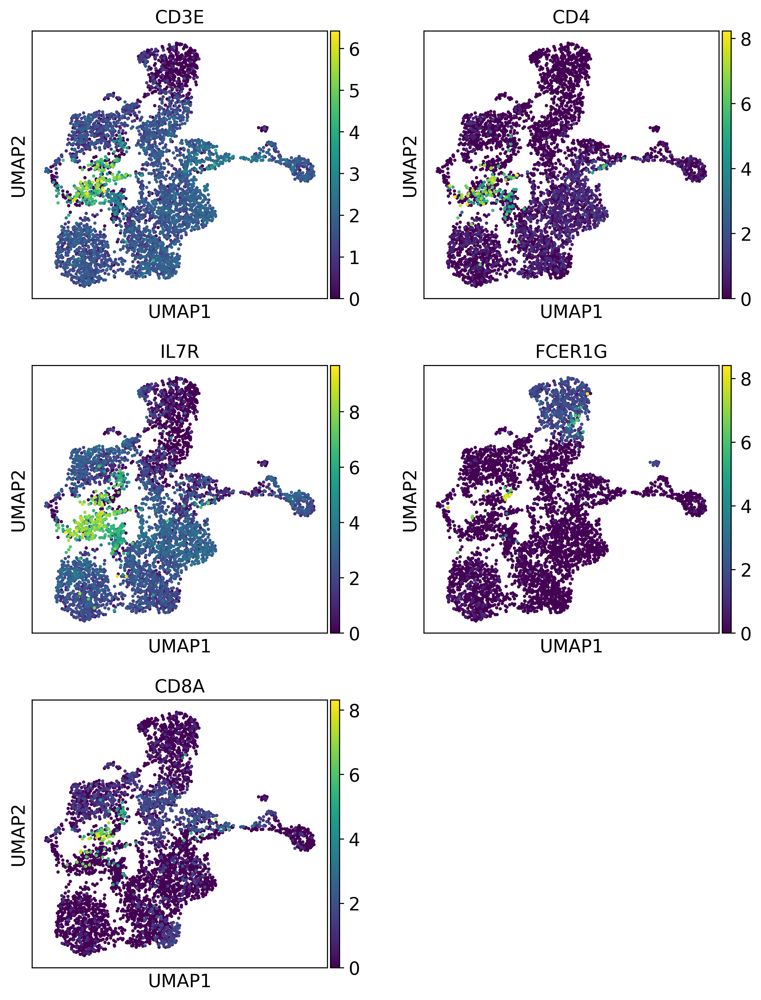

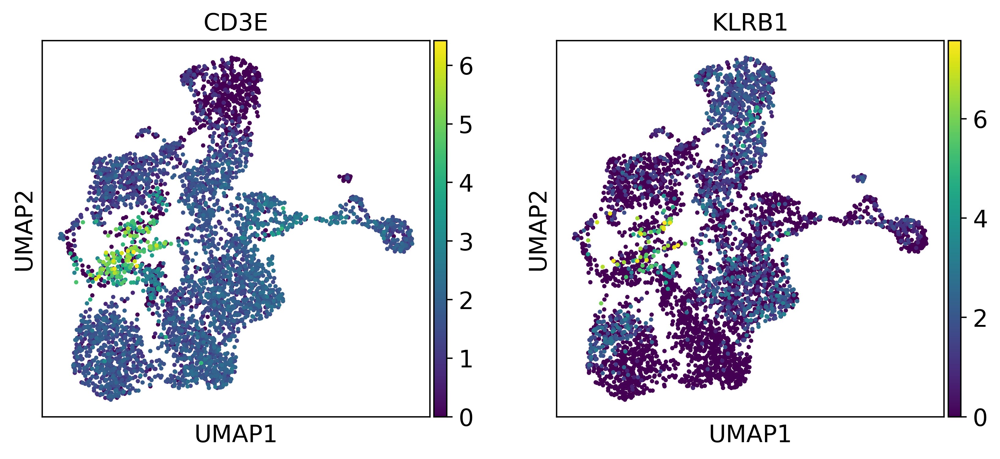

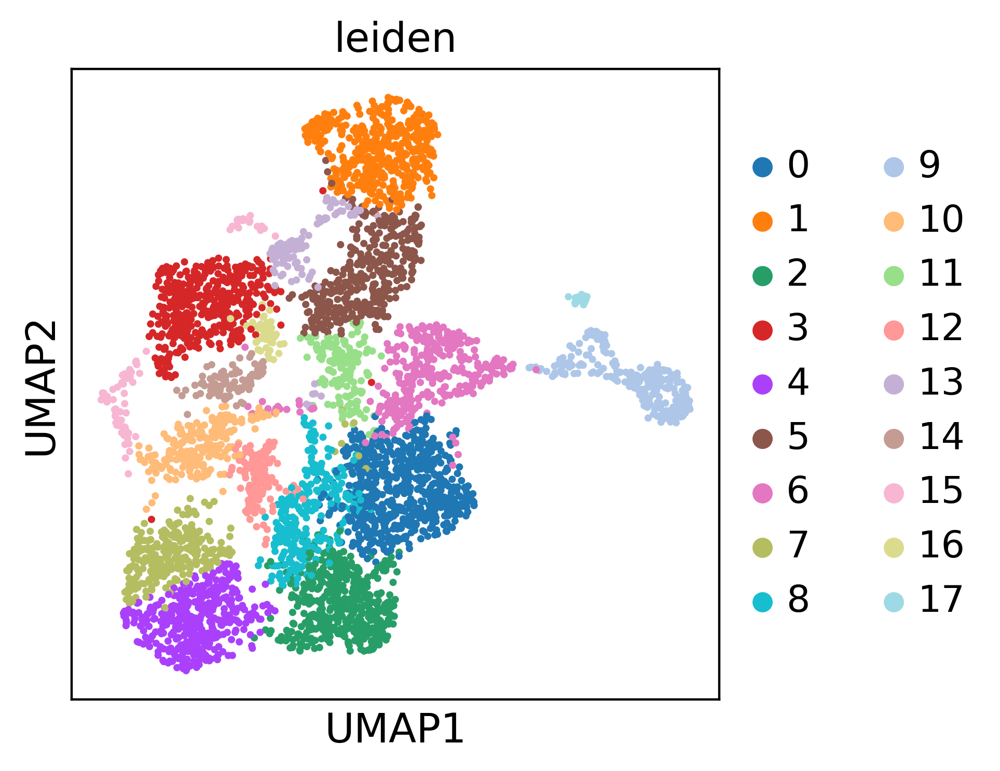

In [138]:
sc.pl.umap(t_nk_cells, color = ["CD3E", "CD4", "IL7R", "FCER1G", "CD8A"],ncols=2) # CD4+ T cells; FCER1G+CD8A are neg marker
# sc.pl.umap(t_nk_cells, color = ["FOXP3", "CTLA4", "IKZF2", "IKZF4", "TNFRSF18", "IL2RA"],
#            ncols=2) # Treg
# sc.pl.umap(t_nk_cells, color = ["CD4","COTL1","CCR7","LEF1","KLRB1"],
#            ncols=2) # Treg

# sc.pl.umap(t_nk_cells, color = ["CD3E", "CD8A", "GZMA", "FCER1G","CD4"], # FCER1G+CD4 are neg marker
#            ncols=3) # CD8
# sc.pl.umap(t_nk_cells, color = ["GZMK", "CD8A", "IL7R", "GZMB","NKG7"], # FCER1G+CD4 are neg marker
#            ncols=3) # CD8

sc.pl.umap(t_nk_cells, color = ["CD3E","KLRB1"],
           ncols=2) # NKT

# sc.pl.umap(t_nk_cells, color = ["AREG","KIT","RORA", "RORC", "IL1R1", "IL2RA",  "IL4", "IL5", "IL13","IL17B",  "GATA3", "NCR2", "CD34"],
#           ncols=2) # inate immune cells

# sc.pl.umap(t_nk_cells, color = ["IL17A","IL17F","IL21","IL22","IL23R"],
#           ncols=2) # Th17 cells

sc.pl.umap(t_nk_cells, color = ['leiden'])


In [214]:
t_nk_cell_type_subclustering = {
    "0": "T cell",
    "1": "NK cell",
    "2": "T cell",
    "3": "CD8-positive, alpha-beta T cell",
    "4": "helper T cell",
    "5": "NKT cell",
    "6" : "memory T cell",
    "7": "helper T cell",
    "8": "T cell",
    "9": "T cell",
    "10": "CD4-positive, alpha-beta T cell",
    "11": "CD8-positive, alpha-beta T cell",
    "12": "innate lymphoid cells",
    "13": "T cell",
    "14": "double-positive, alpha-beta thymocyte",#"CD4 CD8 double positve",
    "15": "naive CD4 T cell",
    "16": "naive CD8 T cell", #CD27 and CD4+CD8+ T cell
    "17": "neutrophil",
}    

In [215]:
organ_adata = remove_cats(organ_adata)
for i in range(18):
    c_aux = t_nk_cells.obs[t_nk_cells.obs["leiden"]==str(i)].index
    organ_adata.obs.loc[c_aux,"annotation_oct2020"] = t_nk_cell_type_subclustering[str(i)]

... storing 'X10X_run' as categorical
... storing 'smartseq2_barcode' as categorical
... storing 'smartseq2_library_plate' as categorical
... storing 'smartseq2_sorting_direction' as categorical
... storing 'smartseq2_sort_order' as categorical
... storing 'smartseq2_cDNA_Plate' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'X10X_replicate' as categorical
... storing 'sequencer' as categorical
... storing 'sex' as categorical
... storing 'tissue' as categorical
... storing 'smartseq2_well_seq' as categorical
... storing 'notes' as categorical
... storing 'smartseq2_sorted_population' as categorical
... storing 'X10X_sample' as categorical
... storing 'anatomical_position' as categorical
... storing 'X10X_barcode' as categorical
... storing 'manual_cell_ontology_class' as categorical
... storing 'manual_annotation' as categorical
... storing 'compartment' as categorical
... storing 'batch' as categorical
... storing 'compartment_pred' 

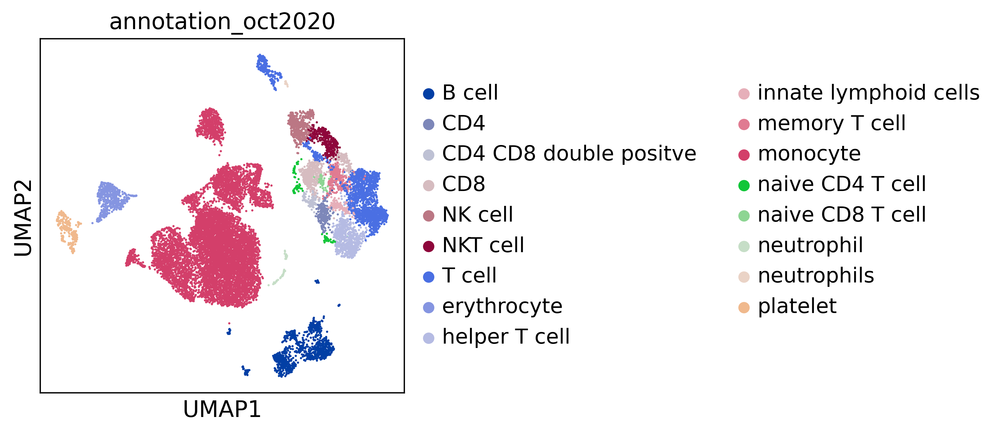

In [216]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

## B cells and plasma cells

In [154]:
b_plasma_cells = organ_adata[organ_adata.obs["annotation_oct2020"].isin(["B cell"])]
b_plasma_cells

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 1105 × 58870
    obs: 'X10X_run', 'smartseq2_barcode', 'smartseq2_library_plate', 'smartseq2_sorting_direction', 'smartseq2_sort_order', 'smartseq2_cDNA_Plate', 'cell_id', 'method', 'donor', 'X10X_replicate', 'sequencer', 'sex', 'tissue', 'smartseq2_well_seq', 'notes', 'smartseq2_sorted_population', 'X10X_sample', 'anatomical_position', 'X10X_barcode', 'n_counts', 'n_genes', 'manual_cell_ontology_class', 'manual_annotation', 'doublet_filter', 'compartment', 'batch', 'compartment_pred', 'leiden', 'cluster_id', 'Propagated.Annotation', 'Entropy.All.Methods', 'Entropy.kNN.Reps', 'Entropy.scANVI.Reps', 'Entropy.SVM.Reps', 'Potential.Doublets', 'Onclass', 'singlecellNet', 'kNN', 'SVM', 'scANVI', 'compartment_pred_svm', 'manual_cell_ontology_classcollapsed', 'Propagated.Annotationcollapsed', 'Onclasscollapsed', 'singlecellNetcollapsed', 'kNNcollapsed', 'SVMcollapsed', 'scANVIcollapsed', 'miscompartmentalized', 'log_n_counts', 'log_n_genes', 'donor

In [164]:
sc.pp.neighbors(b_plasma_cells, use_rep="X_scvi_decontX")#, n_neighbors=10)
sc.tl.umap(b_plasma_cells)
b_plasma_cells.obsm["X_umap_decontX"] = b_plasma_cells.obsm["X_umap"].copy()
sc.tl.leiden(b_plasma_cells, resolution=1)

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


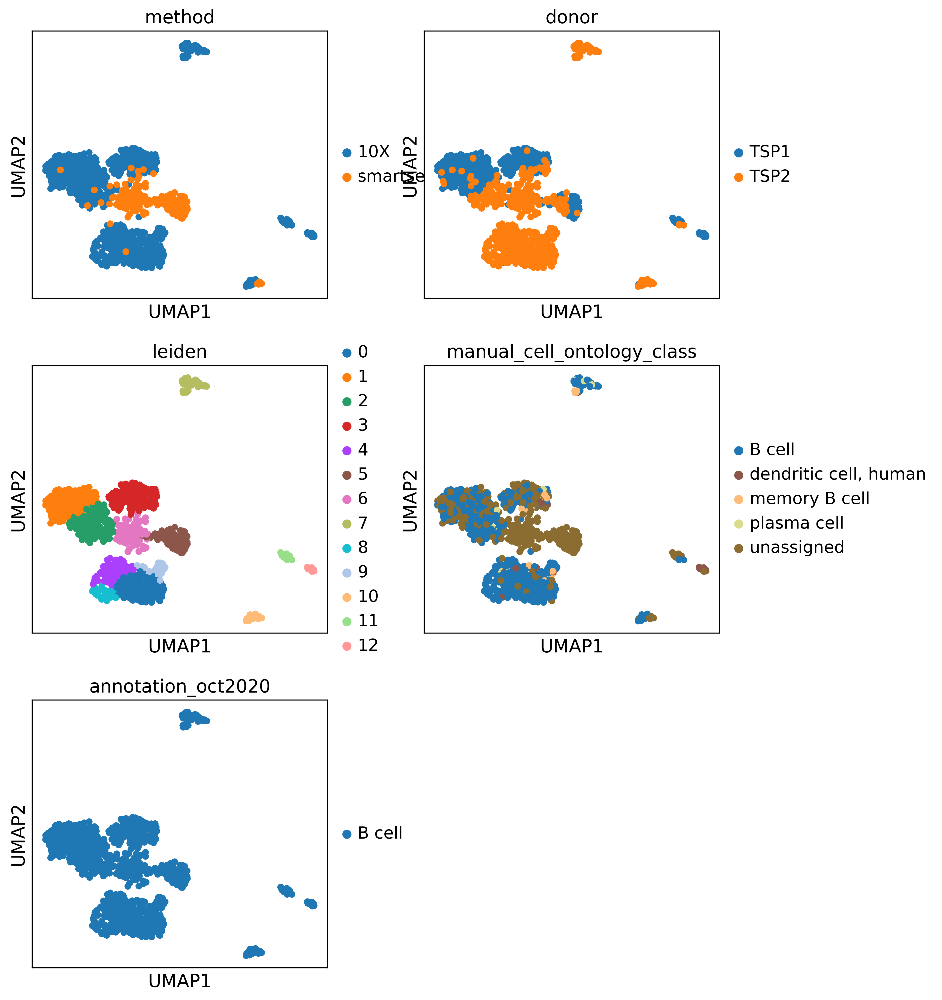

In [165]:
sc.pl.umap(
    b_plasma_cells,
    color=["method", "donor", "leiden", "manual_cell_ontology_class","annotation_oct2020"],
    ncols=2,
)

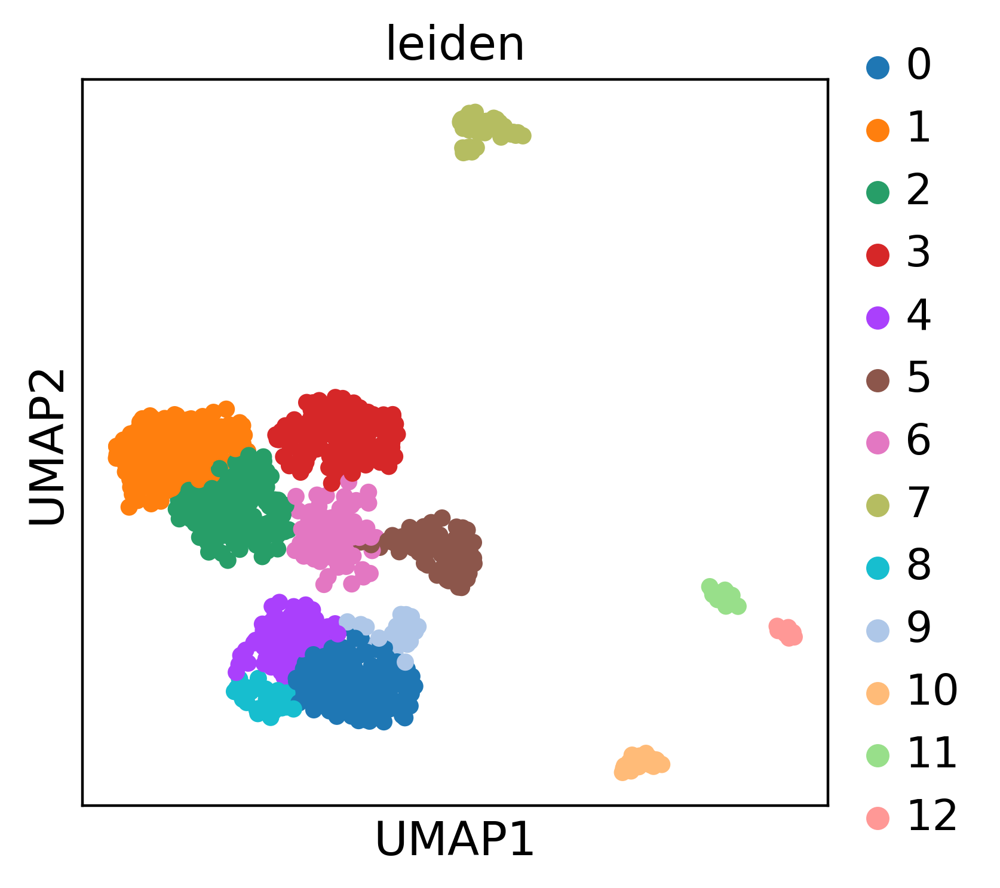

In [166]:
sc.pl.umap(
    b_plasma_cells,
    color=["leiden"],
    ncols=2,
)

In [167]:
sc.tl.rank_genes_groups(b_plasma_cells,'leiden',method='wilcoxon')

In [168]:
pd.DataFrame(b_plasma_cells.uns['rank_genes_groups']['names']).iloc[:20]

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,S100A9,MT-ND3,STX7,CD48,JUND,CD74,TSC22D3,PTPRCAP,PPBP,JUND,PRSS57,FGL2,CLIC3
1,JUND,AL139020.1,LINC02397,HLA-C,PPP1R15A,AC005912.1,TXNIP,GABARAP,NRGN,GPR183,MLLT3,CEBPD,SERPINF1
2,RPL10P9,HVCN1,MARCH1,RPL9P9,JUN,TMSB4X,FP671120.5,ATP6V0C,GNG11,KLF6,SOX4,CST3,LRRC26
3,MTND1P23,RPL9P9,IL4R,RPS29,MYADM,RPS27,EEF1A1P5,IFITM1,TREML1,NR4A2,LAPTM4B,LYZ,GZMB
4,JUN,IGHM,BACH2,HLA-A,YPEL5,RPS19,LAPTM5,MT-ATP8,TIMP1,UBC,H2AFY,AIF1,CLEC4C
5,CD83,LTB,CCR7,TNFRSF13B,TLE1,MALAT1,CD74,HLA-DQA2,CAVIN2,RBM3,EBPL,RAB32,PACSIN1
6,YBX3,VPREB3,POLR2J3-1,AIM2,FOS,MT-CO1,CXCR4,NME2,PF4,RPL10P9,GSTP1,SPI1,MAP1A
7,AL450405.1,LINC02397,PCDH9,HSPA8,S100A9,B2M,TMSB4XP8,CD74,ITGA2B,TNFRSF13C,TALDO1,HLA-DQB1,CD4
8,FOS,CCR7,AC025164.1,IGHG1,BTG1,TMSB4XP8,RPL13AP5,RPS26,CLU,HLA-DQA1,CCT8,JAML,PPP1R14B
9,TSC22D3,CD40,ITPR1,MT-ND3,YBX3,MT-ATP6,FTL,PCBP2,GP9,MAP3K8,EIF3E,CTSZ,TGFBI


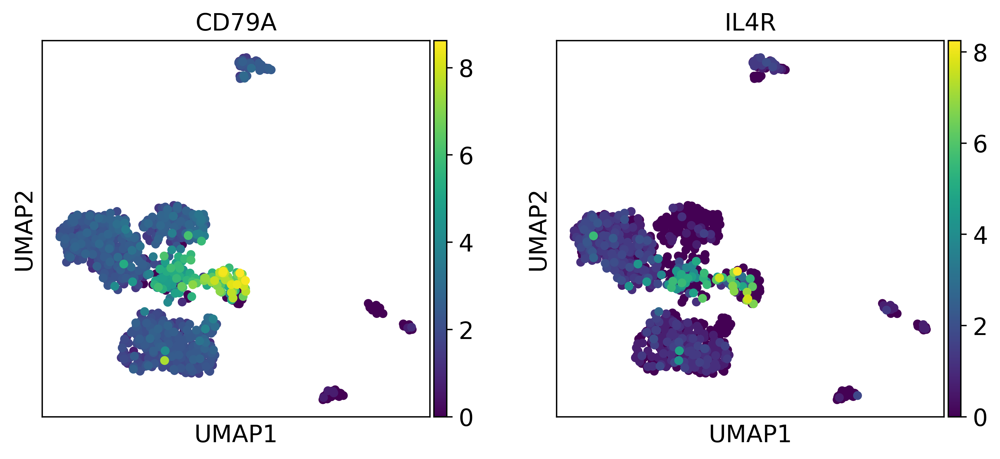

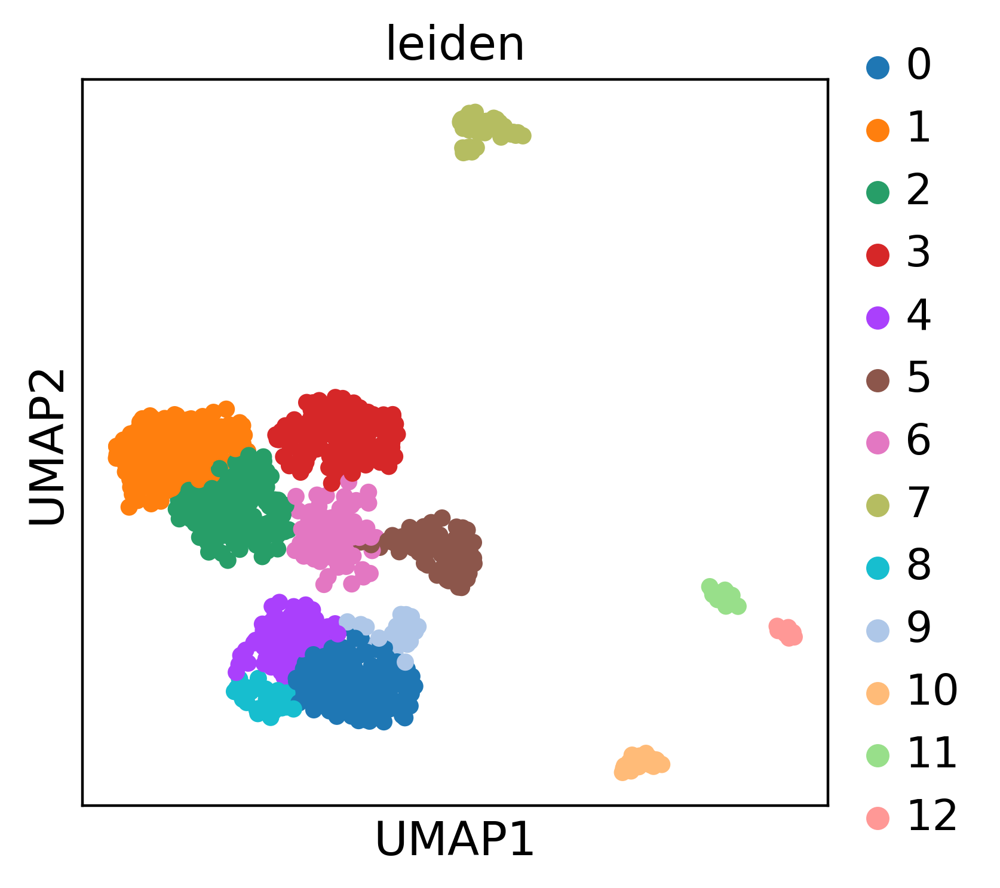

In [183]:
# sc.pl.umap(b_plasma_cells, color = ["CD79A","JCHAIN"],ncols=2) # B cell; plasma cell
sc.pl.umap(b_plasma_cells, color = ["CD79A","IL4R"],ncols=2) # IL4R+ B cell
# sc.pl.umap(b_plasma_cells, color = ["CD79A","CD27","VPREB3"],
#            ncols=2) # memmory b cells
# sc.pl.umap(b_plasma_cells, color = ["MZB1","CD79A","JCHAIN","IRF8"],
#            ncols=2) # mature b cells

# sc.pl.umap(b_plasma_cells, color = ["MZB1","CD79A","JCHAIN","IRF8"],
#            ncols=2) # plasmacytoid dendritic cells
# sc.pl.umap(b_plasma_cells, color = ["CD1C"], # FCER1G+CD4 are neg marker
#            ncols=3) # conventional dendritic cells

# sc.pl.umap(b_plasma_cells, color = ["CD19","CD34","CD38","ITGAM"], 
#            ncols=3) # macrophage


sc.pl.umap(b_plasma_cells, color = ['leiden'])


In [185]:
b_plasma_cell_type_subclustering = {
    "0": "naive B cell",
    "1": "B cell",
    "2": "B cell",
    "3": "memmory B cell",
    "4": "naive B cell",
    "5": "plasma cell",
    "6" : "plasma cell",
    "7": "B cell",
    "8": "naive B cell",
    "9": "naive B cell",
    "10": "immature B cell",
    "11": "conventional dendritic cells",
    "12": "plasmacytoid dendritic cells",
}    

In [217]:
organ_adata = remove_cats(organ_adata)
for i in range(13):
    c_aux = b_plasma_cells.obs[b_plasma_cells.obs["leiden"]==str(i)].index
    organ_adata.obs.loc[c_aux,"annotation_oct2020"] = b_plasma_cell_type_subclustering[str(i)]

# c_aux = t_nk_cells.obs[t_nk_cells.obs["leiden"]=="1"].index
# organ_adata.obs.loc[c_aux,"annotation_oct2020"] = "CD8-positive, alpha-beta T cell"



... storing 'X10X_run' as categorical
... storing 'smartseq2_barcode' as categorical
... storing 'smartseq2_library_plate' as categorical
... storing 'smartseq2_sorting_direction' as categorical
... storing 'smartseq2_sort_order' as categorical
... storing 'smartseq2_cDNA_Plate' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'X10X_replicate' as categorical
... storing 'sequencer' as categorical
... storing 'sex' as categorical
... storing 'tissue' as categorical
... storing 'smartseq2_well_seq' as categorical
... storing 'notes' as categorical
... storing 'smartseq2_sorted_population' as categorical
... storing 'X10X_sample' as categorical
... storing 'anatomical_position' as categorical
... storing 'X10X_barcode' as categorical
... storing 'manual_cell_ontology_class' as categorical
... storing 'manual_annotation' as categorical
... storing 'compartment' as categorical
... storing 'batch' as categorical
... storing 'compartment_pred' 

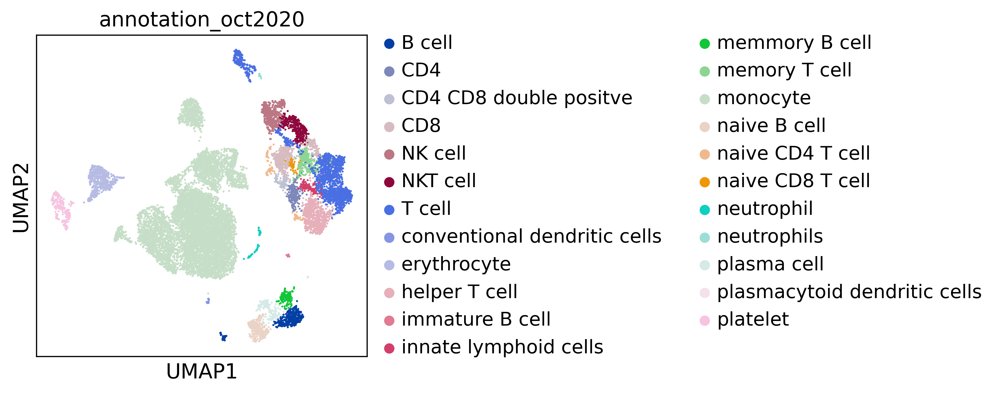

In [218]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

## monocytes

In [188]:
monocyte_cells = organ_adata[organ_adata.obs["annotation_oct2020"].isin(["monocyte"])]
monocyte_cells

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 9564 × 58870
    obs: 'X10X_run', 'smartseq2_barcode', 'smartseq2_library_plate', 'smartseq2_sorting_direction', 'smartseq2_sort_order', 'smartseq2_cDNA_Plate', 'cell_id', 'method', 'donor', 'X10X_replicate', 'sequencer', 'sex', 'tissue', 'smartseq2_well_seq', 'notes', 'smartseq2_sorted_population', 'X10X_sample', 'anatomical_position', 'X10X_barcode', 'n_counts', 'n_genes', 'manual_cell_ontology_class', 'manual_annotation', 'doublet_filter', 'compartment', 'batch', 'compartment_pred', 'leiden', 'cluster_id', 'Propagated.Annotation', 'Entropy.All.Methods', 'Entropy.kNN.Reps', 'Entropy.scANVI.Reps', 'Entropy.SVM.Reps', 'Potential.Doublets', 'Onclass', 'singlecellNet', 'kNN', 'SVM', 'scANVI', 'compartment_pred_svm', 'manual_cell_ontology_classcollapsed', 'Propagated.Annotationcollapsed', 'Onclasscollapsed', 'singlecellNetcollapsed', 'kNNcollapsed', 'SVMcollapsed', 'scANVIcollapsed', 'miscompartmentalized', 'log_n_counts', 'log_n_genes', 'donor

In [189]:
sc.pp.neighbors(monocyte_cells, use_rep="X_scvi_decontX")#, n_neighbors=10)
sc.tl.umap(monocyte_cells)
monocyte_cells.obsm["X_umap_decontX"] = monocyte_cells.obsm["X_umap"].copy()
sc.tl.leiden(monocyte_cells, resolution=1)

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


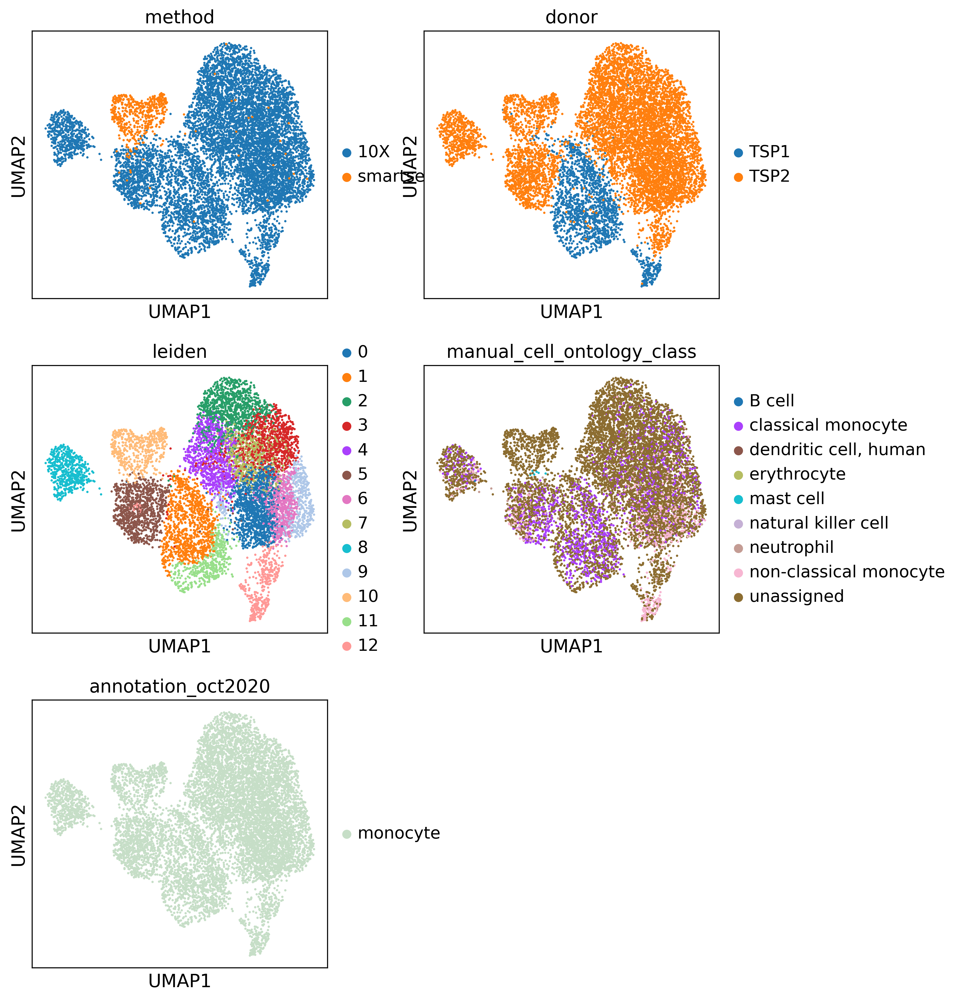

In [190]:
sc.pl.umap(
    monocyte_cells,
    color=["method", "donor", "leiden", "manual_cell_ontology_class","annotation_oct2020"],
    ncols=2,
)

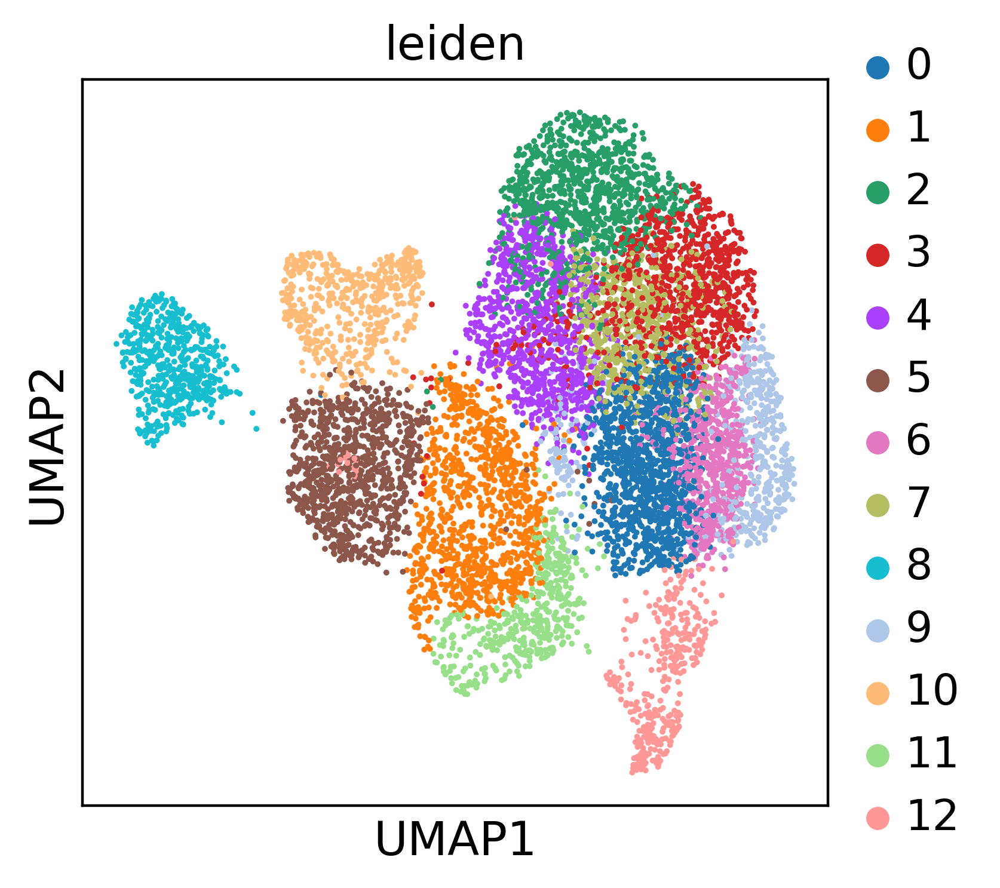

In [191]:
sc.pl.umap(
    monocyte_cells,
    color=["leiden"],
    ncols=2,
)

In [192]:
sc.tl.rank_genes_groups(monocyte_cells,'leiden',method='wilcoxon')

In [193]:
pd.DataFrame(monocyte_cells.uns['rank_genes_groups']['names']).iloc[:20]

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,CD163,VNN2,S100A12,RPS20,FOLR3,MTCO1P12,RNASE1,RPL10P9,GABARAP,PPBP,AL512646.1,HLA-A,FCGR3A
1,VSIG4,LTA4H,ALOX5AP,RPS6,IFITM2,MTCO1P40,RPL10P9,AL450405.1,NME2,PF4,MT-RNR2,FCN1,LST1
2,RNASE1,FPR1,S100A8,RPL13A,RBP7,MTATP6P1,HLA-DPA1,FOLR3,ATP6V0C,TUBB1,MTRNR2L12,ITGB2,TCF7L2
3,TXNIP,RGS2,IL1R2,RPS18,IL1R2,CD163,VSIG4,FTL,ALDOA,NRGN,RPL13P12,MT-ND1,SMIM25
4,MTND1P23,CR1,RETN,RPS11,NAMPT,XIST,RPL10A,S100A10,AL138963.3,ITGA2B,MT-ATP8,MT-CO1,HLA-DPA1
5,KLF9,SELL,FOLR3,RPLP1,ALOX5AP,DDX17,HLA-DRA,BLVRB,IFITM3,TREML1,MALAT1,CPVL,MS4A7
6,FCGR3A,MT-ND1,CDA,LMNA,AC020916.1,FKBP5,CST3,SAP30,IFI30,CAVIN2,RPS28P7,CD14,RPS19
7,KLF10,CD36,AREG,MTND1P23,CXCL8,STAB1,RPS23,C1orf162,CFP,GNG11,FTH1P20,JAML,KLF2
8,MAP3K8,IL17RA,SERPINB1,LGALS1,TNFAIP3,METTL7A,RPS12,RPL11,MIF,HIST1H2AC,FP671120.5,CLEC12A,NAP1L1
9,RPL10P9,JAML,MARC1,S100A9,CLEC4E,ADA2,RPL32,RPL10,GNG5,GP9,TMSB4XP4,CD48,IFITM3


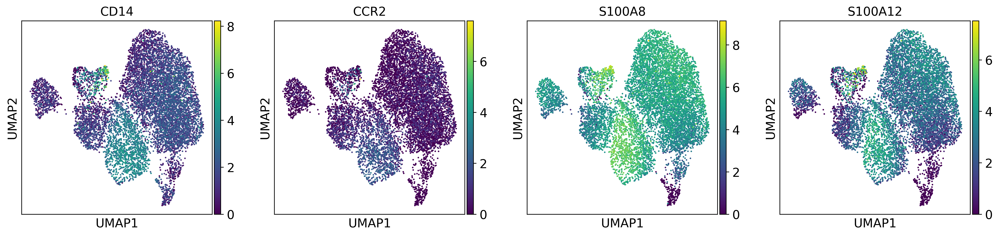

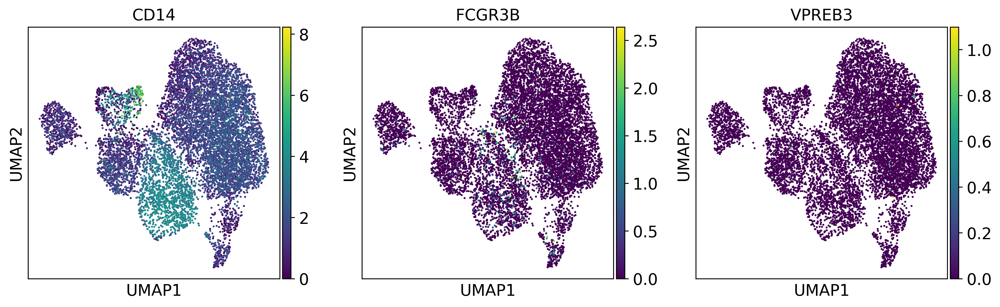

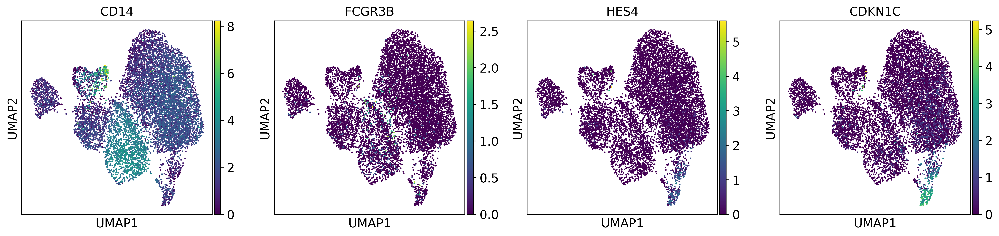

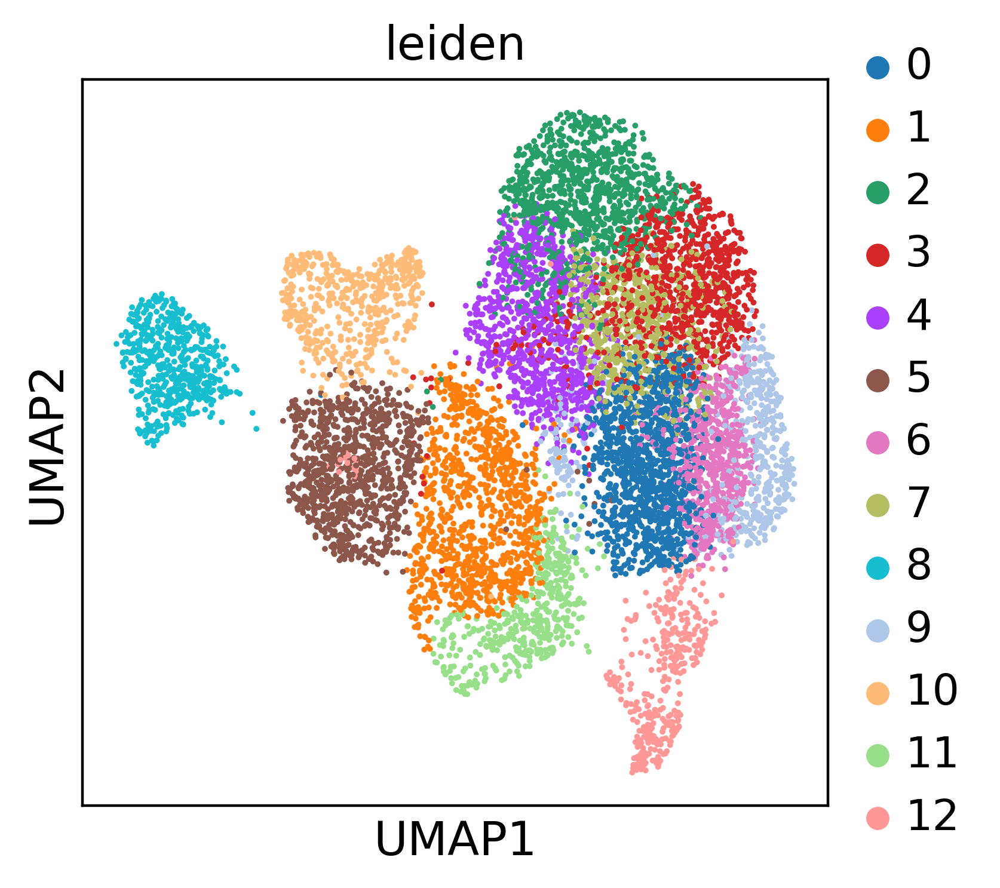

In [197]:
# sc.pl.umap(monocyte_cells, 
#            color = ["TYROBP","S100A8","S100A10","CSF3R","FCN1","LILRA1","LGALS1","AHNAK","VCAN"],
#            ncols=2) # monocyte

sc.pl.umap(monocyte_cells, 
           color = ["CD14","CCR2","S100A8","S100A12"],
           ncols=4) # classical monocytes: CD14+high, CD16-, CCR2+, S100A8+high, S100A12+high, CSF3R+high, HES4-, CDKN1C-, C1QA-, MARCO+low
sc.pl.umap(monocyte_cells, 
           color = ["CD14","FCGR3B","VPREB3"], # CD16 = FCGR3B
           ncols=3) # intermediate monocytes: CD14+high, CD16+, CCR2+/-, S100A8+, S100A12+, CSF3R+, HES4-, CDKN1C-, C1QA-, MARCO+low
sc.pl.umap(monocyte_cells, color = ["CD14","FCGR3B","HES4","CDKN1C"],
           ncols=4) # non-classical monocytes: CD14+, CD16+high, CCR2-, S100A8+low, S100A12-, CSF3R-, HES4+, CDKN1C+, C1QA+sparse, MARCO+low

# sc.pl.umap(monocyte_cells, color = ["MZB1","CD79A","JCHAIN","IRF8"],
#            ncols=2) # plasmacytoid dendritic cells
# sc.pl.umap(monocyte_cells, color = ["CD1C"], # FCER1G+CD4 are neg marker
#            ncols=3) # conventional dendritic cells

# sc.pl.umap(monocyte_cells, color = ["CD19","CD34","CD38","ITGAM"], 
#            ncols=3) # macrophage


sc.pl.umap(monocyte_cells, color = ['leiden'])


In [199]:
monocyte_cell_type_subclustering = {
    "0": "intermediate monocyte",
    "1": "classical monocyte",
    "2": "intermediate monocyte",
    "3": "intermediate monocyte",
    "4": "intermediate monocyte",
    "5": "monocyte",
    "6" : "intermediate monocyte",
    "7": "monocyte",
    "8": "monocyte",
    "9": "intermediate monocyte",
    "10": "classical monocyte",
    "11": "classical monocytes",
    "12": "non-classical monocyte",
}    

In [219]:
organ_adata = remove_cats(organ_adata)
for i in range(13):
    c_aux = monocyte_cells.obs[monocyte_cells.obs["leiden"]==str(i)].index
    organ_adata.obs.loc[c_aux,"annotation_oct2020"] = monocyte_cell_type_subclustering[str(i)]

# c_aux = t_nk_cells.obs[t_nk_cells.obs["leiden"]=="1"].index
# organ_adata.obs.loc[c_aux,"annotation_oct2020"] = "CD8-positive, alpha-beta T cell"



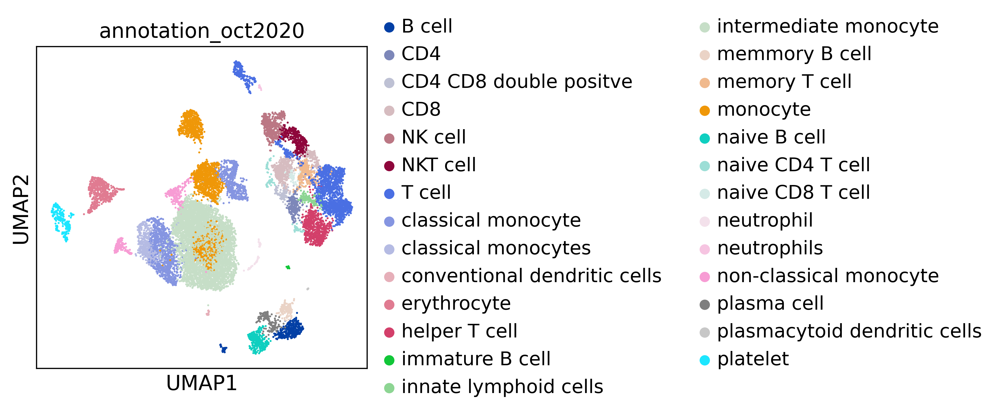

In [221]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# visualize compartment markers

In [222]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [223]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


/home/angela/.local/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


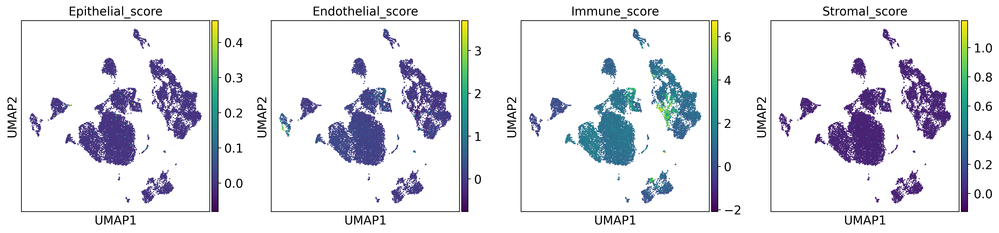

In [224]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# read in cell ontology 

In [30]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [31]:
celltype_dict["T cell"]

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [32]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-positive type I NK T cell secreting interleukin-4',
 'CD4-positive, CD8-intermediate double-positive thymocyte',
 'CD4-positive, alpha-beta T cell',
 'activated CD4-positive, alpha-beta T cell',
 'effector memory CD4-positive, alpha-beta T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'CD4-positive type I NK T cell secreting interferon-gamma',
 'central memory CD4-positive, alpha-beta T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interferon-gamma',
 'CD2-positive, CD5-positive, CD44-positive alpha-beta intraepithelial T cell',
 'CD69-positive, CD4-positive single-positive thymocyte',
 'CD4-positive type I NK T cell',
 'CD4-intermediate, CD8-positive double-positive thymocyte',
 'activated CD4-positive, alpha-beta T cell, human',
 'activated CD4-positive type I NK T cell',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell',
 'mature CD4 single-positive thymoc

# manually create mapping between cell type and compartment (this is just an example)

In [225]:
set(organ_adata.obs['annotation_oct2020'])

{'B cell',
 'CD4',
 'CD4 CD8 double positve',
 'CD8',
 'NK cell',
 'NKT cell',
 'T cell',
 'classical monocyte',
 'classical monocytes',
 'conventional dendritic cells',
 'erythrocyte',
 'helper T cell',
 'immature B cell',
 'innate lymphoid cells',
 'intermediate monocyte',
 'memmory B cell',
 'memory T cell',
 'monocyte',
 'naive B cell',
 'naive CD4 T cell',
 'naive CD8 T cell',
 'neutrophil',
 'neutrophils',
 'non-classical monocyte',
 'plasma cell',
 'plasmacytoid dendritic cells',
 'platelet'}

In [226]:
organ_adata.obs["compartment_oct2020"] = "Immune"#organ_adata.obs["annotation_oct2020"].copy()

# Visualize the results of the new compartment splitting

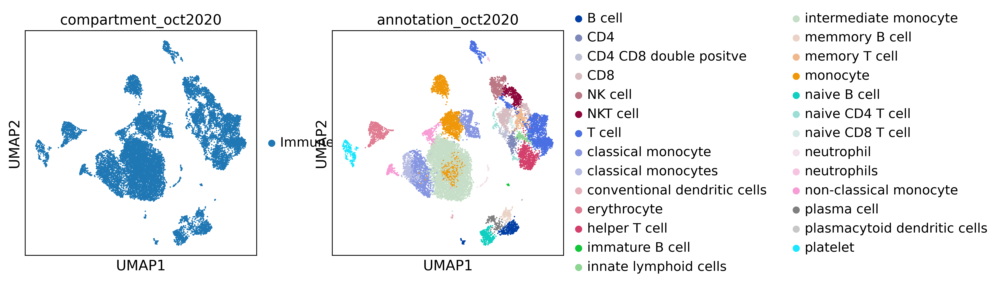

In [228]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020","annotation_oct2020"],
    ncols=2,
)

# save data

In [83]:
data_path

'/mnt/ibm_lg/angela/sapiens/data/'

In [84]:
organ_adata.write_h5ad(
    data_path + "decontX/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)